#### quick start

In [1]:
import sys
import os
sys.path.append(os.path.abspath('../src/segment_3_dataset_images'))
from faccent import render, param, transform, objectives

In [2]:
#load model
import torch
from faccent.modelzoo import inceptionv1

DEVICE = 'cuda:0'
model = inceptionv1(pretrained=True)
_ = model.to(DEVICE).eval()
# MODEL_INPUT_SIZE = model.model_input_size
# MODEL_INPUT_RANGE = model.model_input_range
# IMG_SIZE = (512,512)


#labels for model
with open('../src/segment_3_dataset_images/faccent/modelzoo/inceptionv1/inception_labels.txt', 'r') as f:
    category_targets= f.read().splitlines()


In [3]:
#image to accentuate
img_path = '../data/segment_3_test_images/iguana.jpg/'

#feature to accentuate (logit)
layer = 'softmax2_pre_activation_matmul'

#label = 'monarch'
label = 'loggerhead'
unit = category_targets.index(label)

initializing parameterization with ../data/segment_3_test_images/iguana.jpg/
reg_layer arg set, but not reg_alpha, use reg_alpha=1
using parameterizer.standard_transforms
Initial loss: -8.763
obj/reg ratio: 0.14109815992303587
setting reg balance parameter to this ratio


  0%|          | 0/99 [00:00<?, ?it/s]

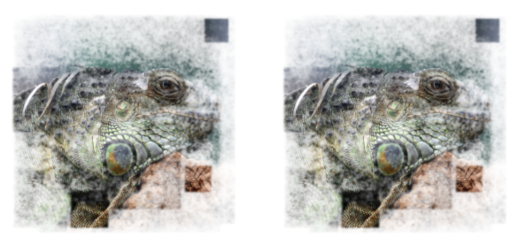

 10%|█         | 10/99 [00:05<00:41,  2.15it/s]

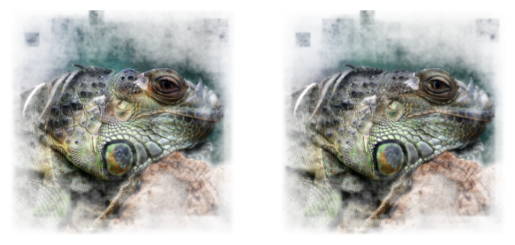

 20%|██        | 20/99 [00:11<00:39,  2.02it/s]

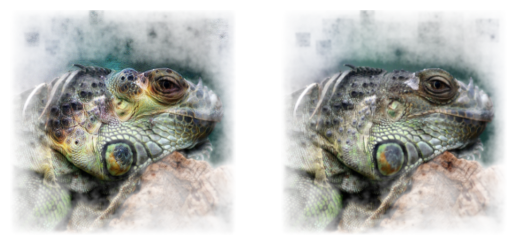

 30%|███       | 30/99 [00:15<00:29,  2.38it/s]

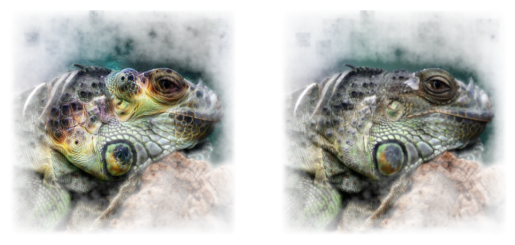

 40%|████      | 40/99 [00:20<00:29,  2.02it/s]

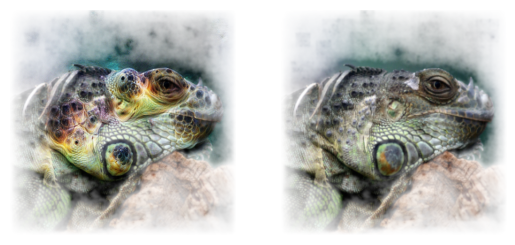

 51%|█████     | 50/99 [00:25<00:20,  2.41it/s]

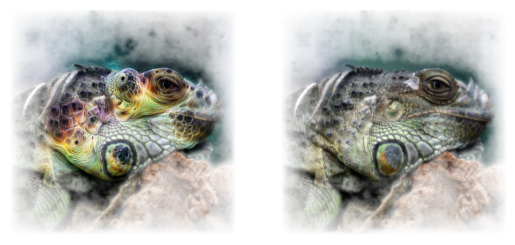

 61%|██████    | 60/99 [00:30<00:16,  2.32it/s]

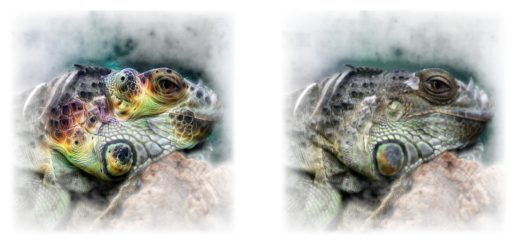

 71%|███████   | 70/99 [00:35<00:13,  2.17it/s]

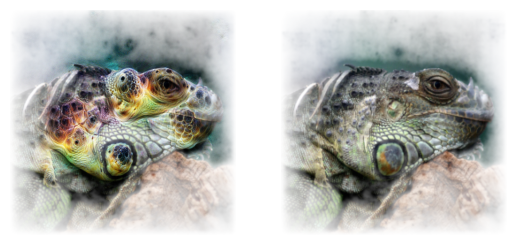

 81%|████████  | 80/99 [00:40<00:08,  2.18it/s]

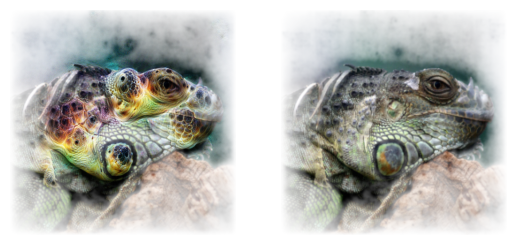

 91%|█████████ | 90/99 [00:45<00:03,  2.31it/s]

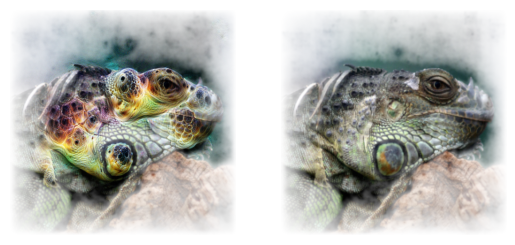

 99%|█████████▉| 98/99 [00:49<00:00,  2.16it/s]

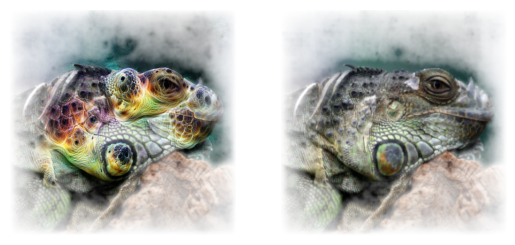

100%|██████████| 99/99 [00:50<00:00,  1.97it/s]


In [4]:
obj = layer+':'+str(unit)
imgs, img_trs, _, _ = render.render_vis(
                                    model,
                                    obj,
                                    init_img = img_path,
                                    accent_reg_layer = 'mixed3a'
                                  )

In [5]:
#an interactive widget

from faccent.utils import accent_widget

accent_widget(imgs, img_trs)

interactive(children=(IntSlider(value=0, description='Opt Steps:', max=49), FloatSlider(value=100.0, descripti…

#### normal (noise-seeded) feature visualization

no image specified, so intializing with random noise"
using parameterizer.standard_transforms


  0%|          | 0/99 [00:00<?, ?it/s]

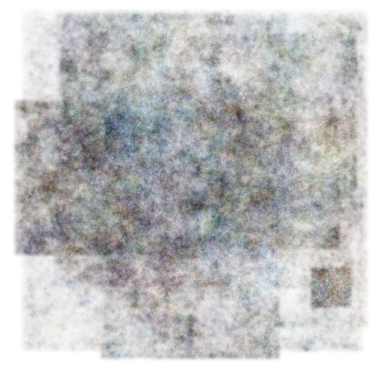

 10%|█         | 10/99 [00:02<00:12,  7.14it/s]

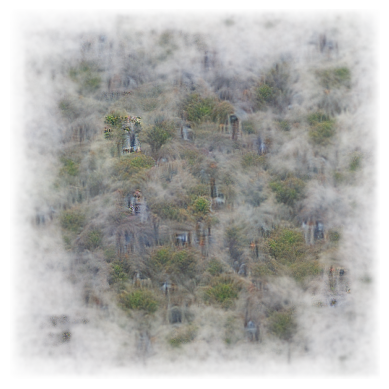

 20%|██        | 20/99 [00:03<00:10,  7.30it/s]

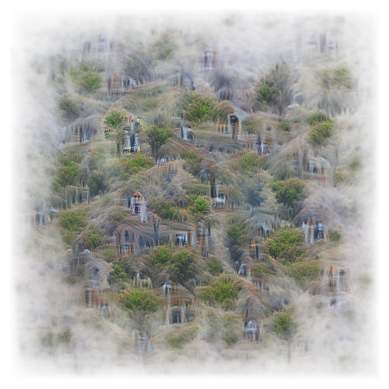

 30%|███       | 30/99 [00:05<00:09,  6.91it/s]

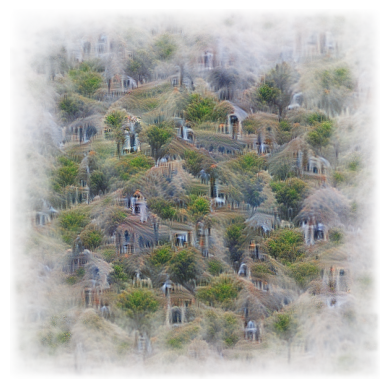

 40%|████      | 40/99 [00:07<00:09,  6.43it/s]

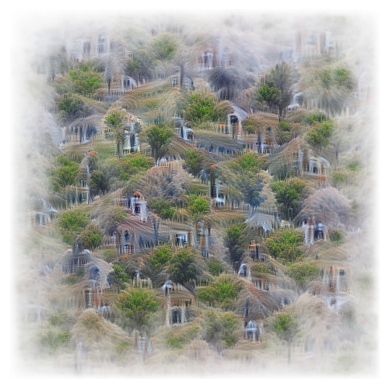

 51%|█████     | 50/99 [00:08<00:07,  6.95it/s]

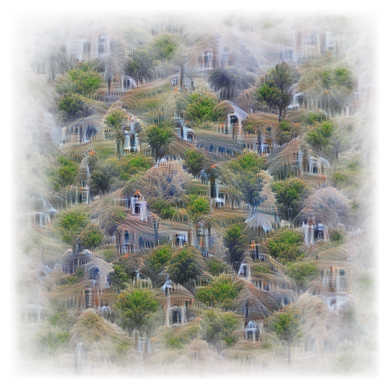

 61%|██████    | 60/99 [00:10<00:05,  6.95it/s]

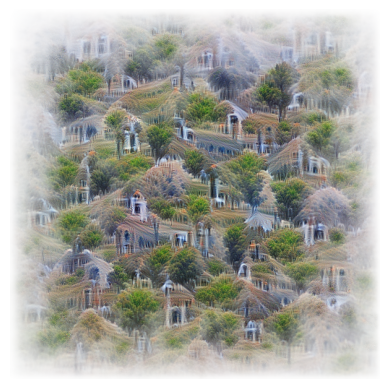

 71%|███████   | 70/99 [00:12<00:05,  5.20it/s]

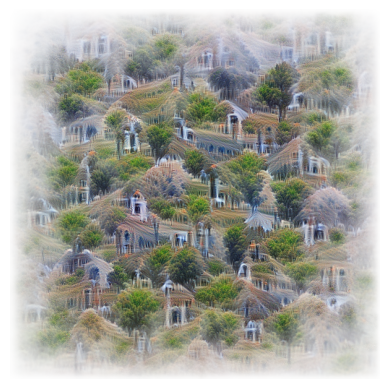

 81%|████████  | 80/99 [00:14<00:02,  7.06it/s]

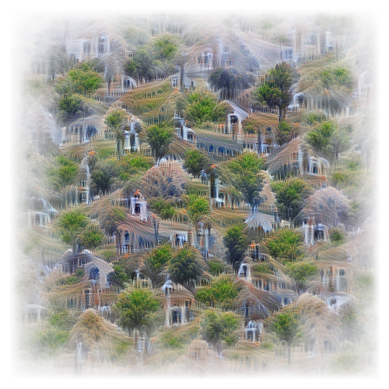

 91%|█████████ | 90/99 [00:15<00:01,  6.53it/s]

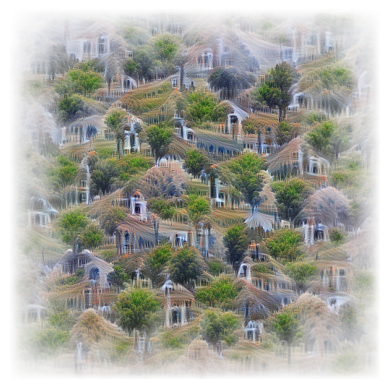

 99%|█████████▉| 98/99 [00:17<00:00,  7.06it/s]

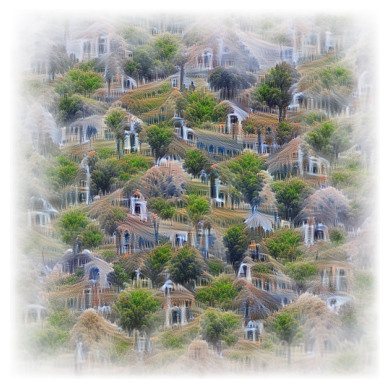

100%|██████████| 99/99 [00:17<00:00,  5.64it/s]


In [6]:
_ = render.render_vis(model, "mixed4a:475") 

#### latent accentuation

initializing parameterization with ../data/segment_3_test_images/fox.jpg
using parameterizer.standard_transforms
Initial loss: -27.472
obj/reg ratio: 1.0961066472472107
setting reg balance parameter to this ratio


  0%|          | 0/99 [00:00<?, ?it/s]

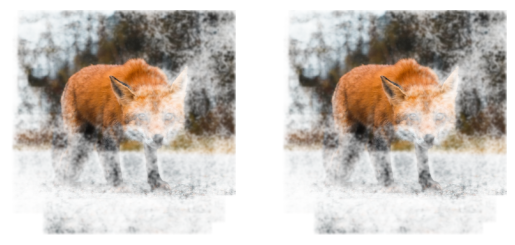

 10%|█         | 10/99 [00:03<00:27,  3.24it/s]

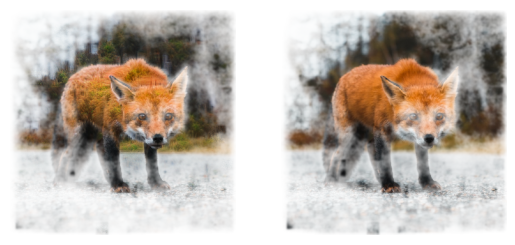

 20%|██        | 20/99 [00:06<00:24,  3.18it/s]

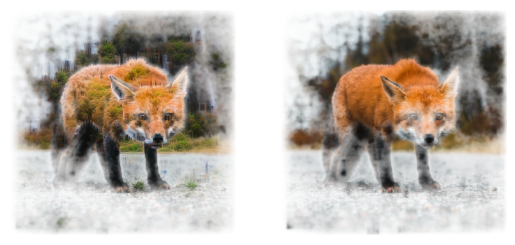

 30%|███       | 30/99 [00:10<00:24,  2.81it/s]

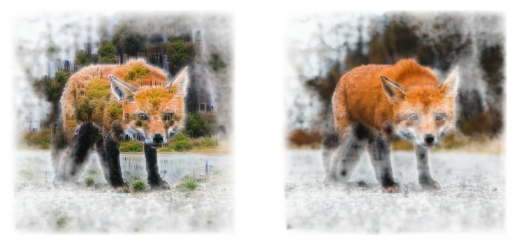

 40%|████      | 40/99 [00:14<00:18,  3.13it/s]

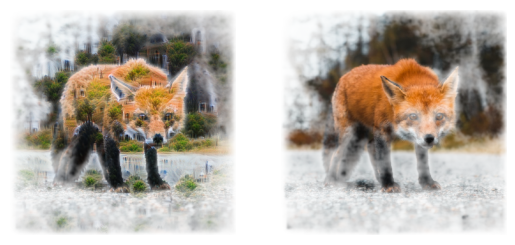

 51%|█████     | 50/99 [00:17<00:15,  3.07it/s]

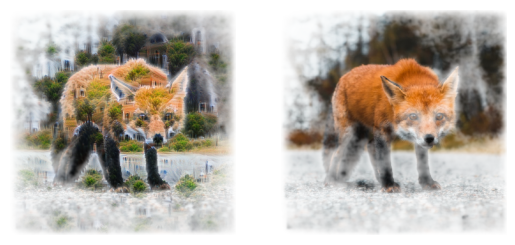

 61%|██████    | 60/99 [00:21<00:12,  3.08it/s]

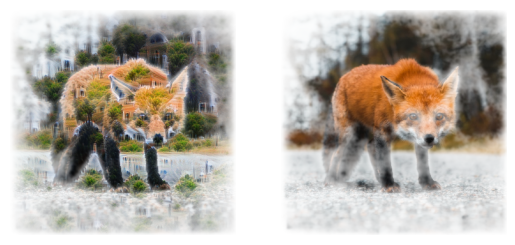

 71%|███████   | 70/99 [00:25<00:09,  3.18it/s]

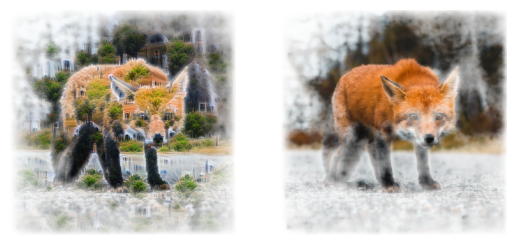

 81%|████████  | 80/99 [00:28<00:06,  3.10it/s]

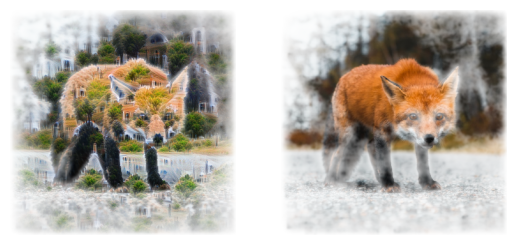

 91%|█████████ | 90/99 [00:31<00:02,  3.50it/s]

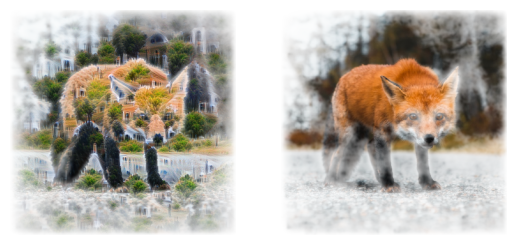

 99%|█████████▉| 98/99 [00:34<00:00,  3.43it/s]

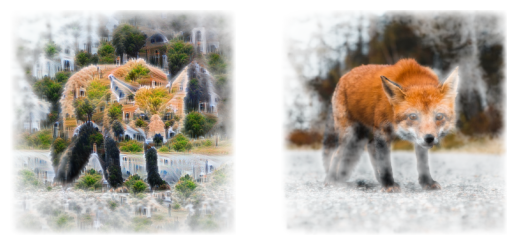

100%|██████████| 99/99 [00:34<00:00,  2.83it/s]


In [8]:
imgs, img_trs, _, _ = render.render_vis(model, 
                      "mixed4a:475",
                      init_img = '../data/segment_3_test_images/fox.jpg',
                      accent_reg_layer = 'conv2d2',
                      accent_reg_alpha = 1.
                      )

### Finer control

#### no augmentations or parameterization

  0%|          | 0/151 [00:00<?, ?it/s]

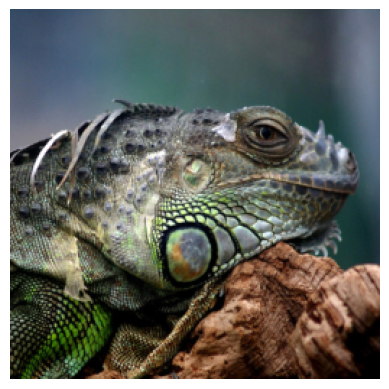

 13%|█▎        | 20/151 [00:03<00:21,  6.23it/s]

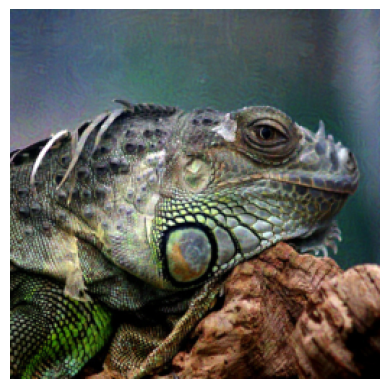

 26%|██▋       | 40/151 [00:06<00:17,  6.33it/s]

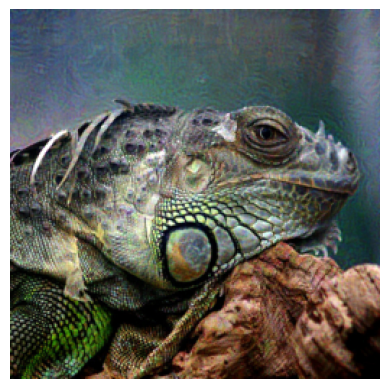

 40%|███▉      | 60/151 [00:10<00:13,  6.66it/s]

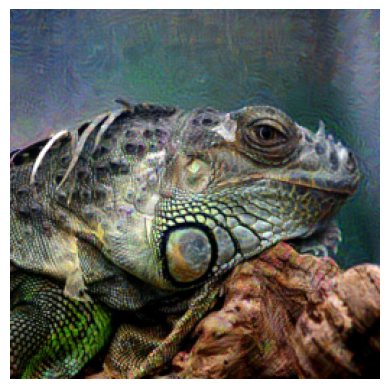

 53%|█████▎    | 80/151 [00:13<00:10,  6.52it/s]

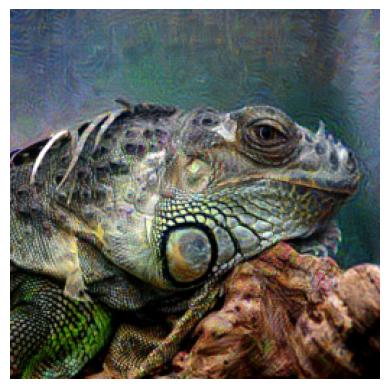

 66%|██████▌   | 100/151 [00:17<00:07,  6.48it/s]

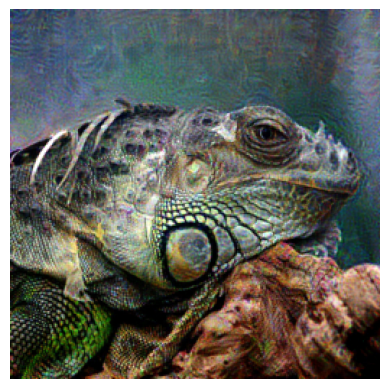

 79%|███████▉  | 120/151 [00:20<00:04,  6.42it/s]

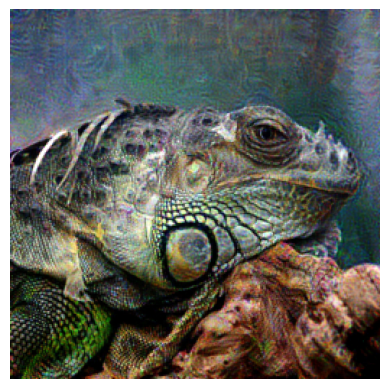

 93%|█████████▎| 140/151 [00:24<00:01,  6.68it/s]

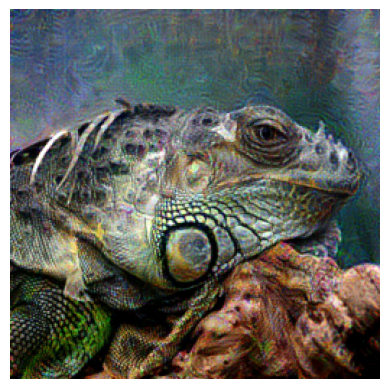

 99%|█████████▉| 150/151 [00:25<00:00,  6.44it/s]

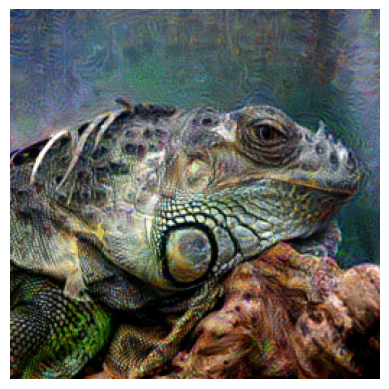

100%|██████████| 151/151 [00:26<00:00,  5.77it/s]


In [9]:
#activation maximization only

#in what space do we parameterization the image? (this is where we measure gradients)
parameterizer = param.pixel(init_img='../data/segment_3_test_images/iguana.jpg',
                            color_decorrelate=False,
                            device=DEVICE)

#what augmentation scheme do you apply?
transforms = [] #no augmentations

#objective what are you trying to maximize in the model?
layer = 'softmax2_pre_activation_matmul'
label = 'terrapin'
unit = category_targets.index(label)
obj = objectives.channel(layer,unit)


_ = render.render_vis(model,
                      obj,
                      parameterizer,
                      transforms = transforms,
                      out_thresholds = [150],
                      inline_thresholds = range(0,150,20),
                      trans_p=0)

#### fourier phase parameterization

  0%|          | 0/151 [00:00<?, ?it/s]

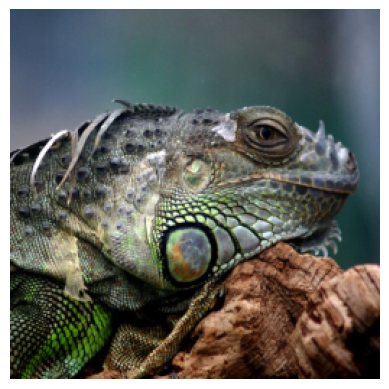

 13%|█▎        | 20/151 [00:04<00:26,  4.92it/s]

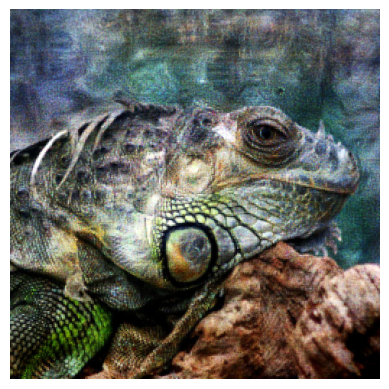

 26%|██▋       | 40/151 [00:07<00:19,  5.73it/s]

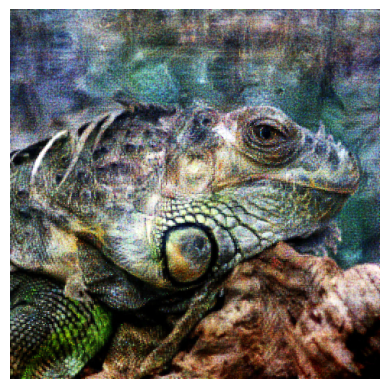

 40%|███▉      | 60/151 [00:11<00:16,  5.61it/s]

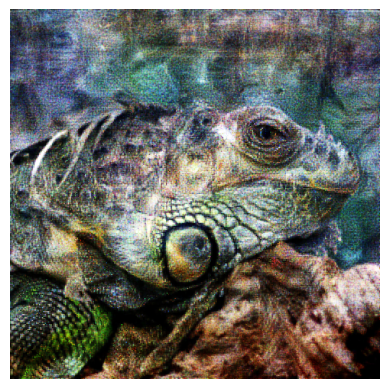

 53%|█████▎    | 80/151 [00:15<00:14,  5.00it/s]

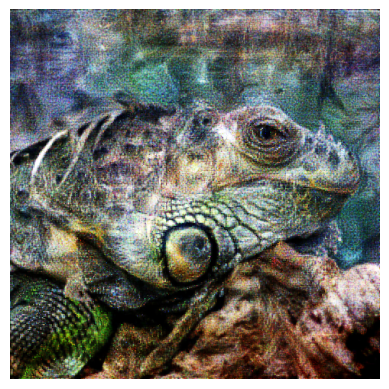

 66%|██████▌   | 100/151 [00:19<00:09,  5.65it/s]

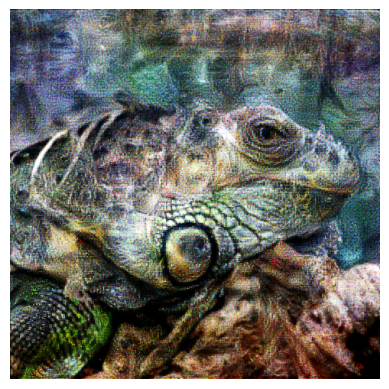

 79%|███████▉  | 120/151 [00:23<00:05,  5.76it/s]

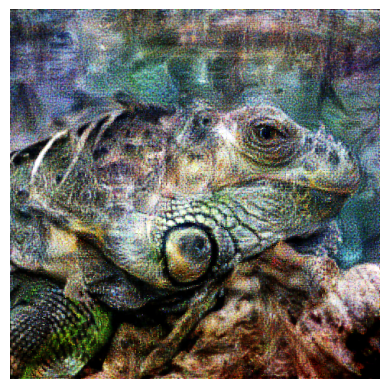

 93%|█████████▎| 140/151 [00:27<00:01,  5.68it/s]

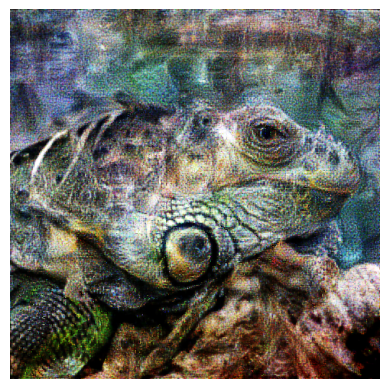

 99%|█████████▉| 150/151 [00:29<00:00,  5.58it/s]

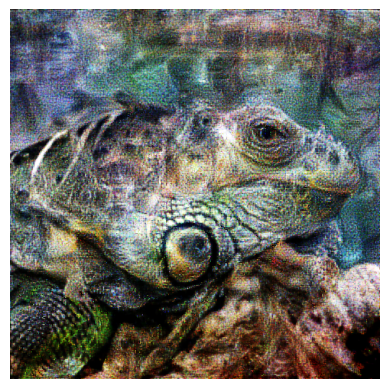

100%|██████████| 151/151 [00:29<00:00,  5.13it/s]


In [10]:
#fourier with decorrelated color space

#in what space do we parameterization the image? (this is where we measure gradients)
parameterizer = param.fourier_phase(init_img='../data/segment_3_test_images/iguana.jpg',
                              device=DEVICE)

#what augmentation scheme do you apply?
transforms = [] #no augmentations

#objective what are you trying to maximize in the model?
obj = objectives.channel(layer,unit)


_ = render.render_vis(model,
                      obj,
                      parameterizer,
                      transforms = transforms,
                      out_thresholds = [150],
                      inline_thresholds = range(0,150,20),
                      trans_p=0)

#### augmentations

##### box crop transformations

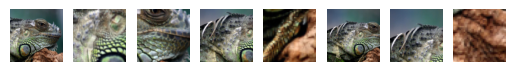

In [11]:
#in what space do we parameterization the image? (this is where we measure gradients)
parameterizer = param.fourier(init_img='../data/segment_3_test_images/iguana.jpg',
                              device=DEVICE)

#what augmentation scheme do you apply?
transforms = [transform.box_crop_2(box_min_size=.05,
                                   box_max_size = .99),
              transform.resize((512,512))]
transform_f = transform.compose(transforms,nb_transforms=8)


transformed_images = transform_f(parameterizer.params_to_img())

from faccent.utils import show
show(transformed_images)

##### jitter transformations

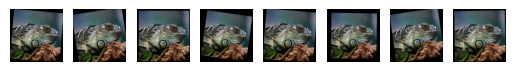

In [12]:
#in what space do we parameterization the image? (this is where we measure gradients)
parameterizer = param.fourier(init_img='../data/segment_3_test_images/iguana.jpg',
                              device=DEVICE)

#what augmentation scheme do you apply?
transforms = transform.standard_jitter_transforms+[transform.resize((512,512))]
transform_f = transform.compose(transforms,nb_transforms=8)


transformed_images = transform_f(parameterizer.params_to_img())

from faccent.utils import show
show(transformed_images)

#### optimize with custom  parameterization, transforms, and regularization

  0%|          | 0/151 [00:00<?, ?it/s]

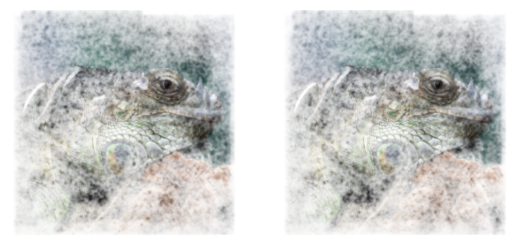

 13%|█▎        | 20/151 [00:05<00:36,  3.57it/s]

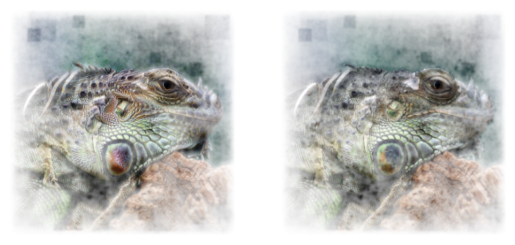

 26%|██▋       | 40/151 [00:11<00:28,  3.88it/s]

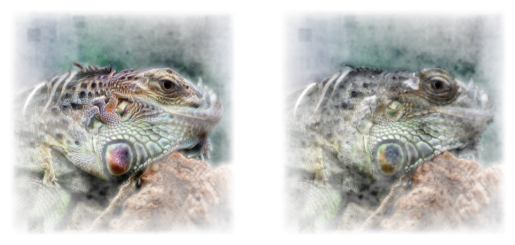

 40%|███▉      | 60/151 [00:17<00:26,  3.39it/s]

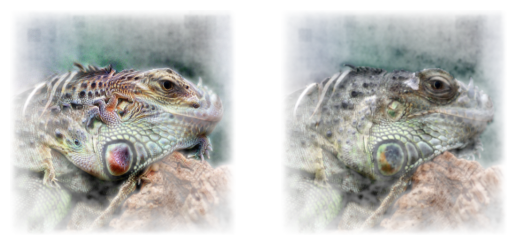

 53%|█████▎    | 80/151 [00:23<00:18,  3.84it/s]

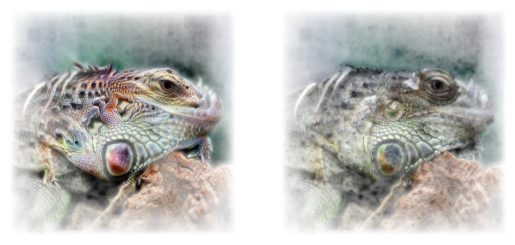

 66%|██████▌   | 100/151 [00:29<00:13,  3.76it/s]

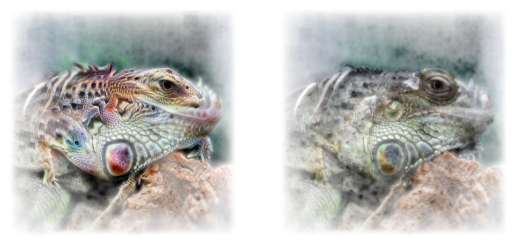

 79%|███████▉  | 120/151 [00:34<00:07,  4.00it/s]

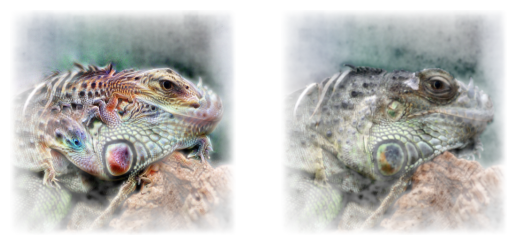

 93%|█████████▎| 140/151 [00:40<00:02,  4.00it/s]

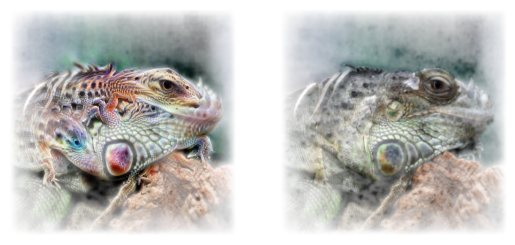

 99%|█████████▉| 150/151 [00:43<00:00,  3.85it/s]

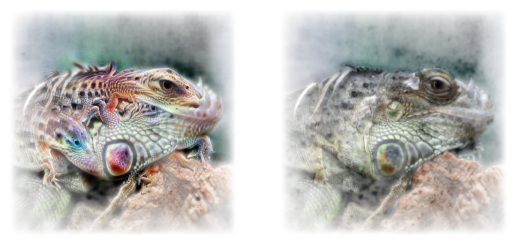

100%|██████████| 151/151 [00:43<00:00,  3.44it/s]


In [13]:
#in what space do we parameterization the image? (this is where we measure gradients)
parameterizer = param.fourier(init_img='../data/segment_3_test_images/iguana.jpg',
                              device=DEVICE,
                              forward_init_img= True)  #for regularization

#what augmentation scheme do you apply?
transforms = [
              transform.box_crop_2(box_min_size=.05,
                                   box_max_size = .99),
              transform.uniform_gaussian_noise()
             ]


layer = 'softmax2_pre_activation_matmul'
label = 'whiptail'
unit = category_targets.index(label)

#objective what are you trying to maximize in the model?
obj1 = objectives.channel(layer,unit)    #maximization target
obj2 = objectives.l2_compare('mixed3a')           # regularization target
obj = obj1-.1*obj2


_ = render.render_vis(model,
                      obj,
                      parameterizer,
                      transforms = transforms,
                      out_thresholds = [150],
                      inline_thresholds = range(0,150,20),
                      trans_p=5)

#### neuron-wise visualization

  0%|          | 0/151 [00:00<?, ?it/s]

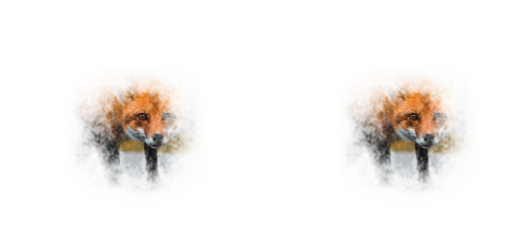

 13%|█▎        | 20/151 [00:07<00:42,  3.07it/s]

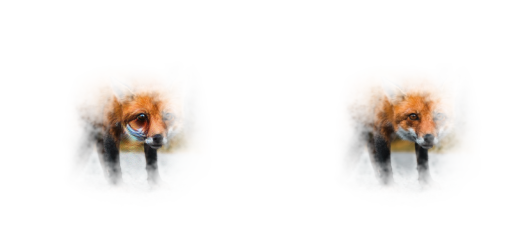

 26%|██▋       | 40/151 [00:14<00:40,  2.76it/s]

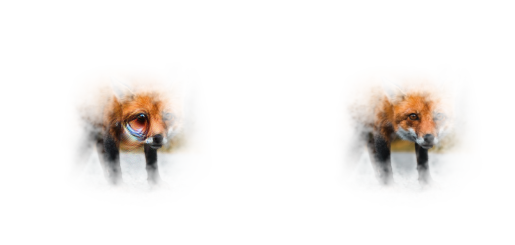

 40%|███▉      | 60/151 [00:20<00:27,  3.34it/s]

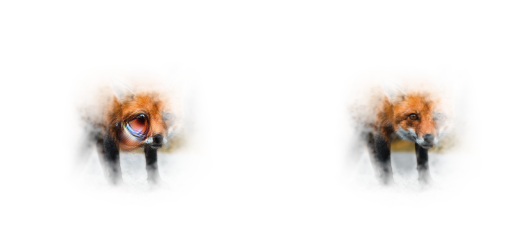

 53%|█████▎    | 80/151 [00:27<00:21,  3.30it/s]

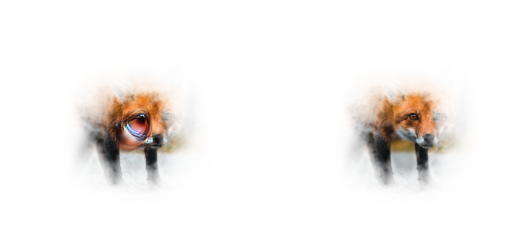

 66%|██████▌   | 100/151 [00:33<00:15,  3.34it/s]

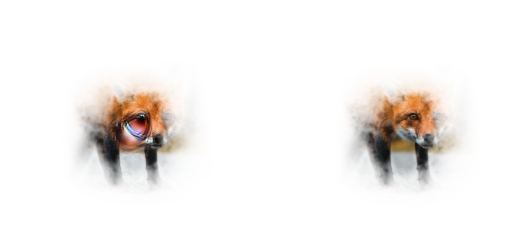

 79%|███████▉  | 120/151 [00:40<00:09,  3.34it/s]

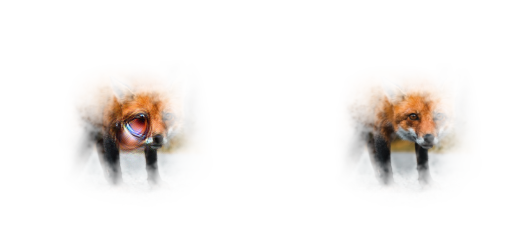

 93%|█████████▎| 140/151 [00:46<00:03,  3.32it/s]

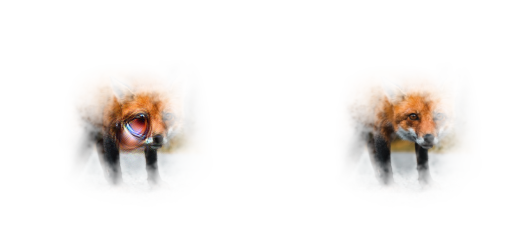

 99%|█████████▉| 150/151 [00:49<00:00,  3.28it/s]

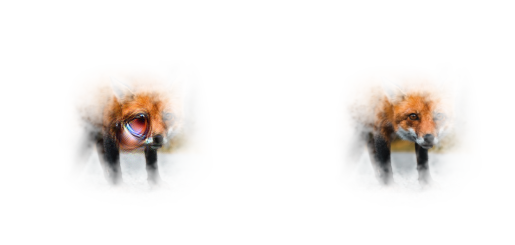

100%|██████████| 151/151 [00:50<00:00,  3.00it/s]


In [14]:
#in what space do we parameterization the image? (this is where we measure gradients)
parameterizer = param.fourier(init_img='../data/segment_3_test_images/fox.jpg',
                              device=DEVICE,
                              forward_init_img= True)  #for regularization

#what augmentation scheme do you apply?
transforms = [
              transform.box_crop_2(box_min_size=.7,
                                   box_max_size = .99),
              transform.uniform_gaussian_noise()
             ]

obj1 = objectives.neuron('mixed4b',0) 
obj2 = objectives.l2_compare('mixed3a')     
obj = obj1-5*obj2


_ = render.render_vis(model,
                      obj,
                      parameterizer,
                      transforms = transforms,
                      out_thresholds = [150],
                      inline_thresholds = range(0,150,20),
                      trans_p=5,
                      img_tr_obj = obj1) # show transparency only with respect to maximization objective